Filtres: shuffle, bitshuffle
Còdecs: blosclz, zstd

CONCLUSIONS: blosclz-shuffle i blosclz-bitshuffle se superposen
             zstd-shuffle i zstd-bitshuffle se superposen
             
Probem amb zlib, lz4 i lz4hc; i veem que ocorre el mateix.

Per tant, la red no pot diferenciar per a un códec donat, entre un filtre o un altre perquè donen resultats practicament idèntics.

In [75]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np

In [76]:
from pathlib import Path
path = Path('../data_inputs_temp/')

In [77]:
ficheros = ['entropy-shuffle', 'entropy-bitshuffle',
            'zlib-shuffle-split', 'zlib-bitshuffle-split', 
            'lz4hc-shuffle-split', 'lz4hc-bitshuffle-split']

ficheros_path = [str(path) + '/' + fichero + '.csv.gz' for fichero in ficheros]
dataframes1 = {}
nsplits = [55296] * 6

for i in range(0, 2):
    dataframes1[ficheros[i]] = pd.read_csv(ficheros_path[i], delimiter=',')
    codec_filter = np.repeat(ficheros[i], nsplits[i])
    dataframes1[ficheros[i]]['codec_filter'] = codec_filter
    
    categoria = np.repeat(str(30+i), nsplits[i])
    dataframes1[ficheros[i]]['categoria'] = categoria
    
    dataframes1[ficheros[i]].rename(columns = {'cratio':'cratio', ' speed':'speed', ' special_vals':'special_vals', ' nchunk':'nchunk', ' category':'category'}, inplace = True)
    
for i in range(2, len(ficheros)):
    dataframes1[ficheros[i]] = pd.read_csv(ficheros_path[i], delimiter=',')
    codec_filter = np.repeat(ficheros[i], nsplits[i])
    dataframes1[ficheros[i]]['codec_filter'] = codec_filter
    
    categoria = np.repeat(i-2, nsplits[i])
    dataframes1[ficheros[i]]['categoria'] = categoria
    
    dataframes1[ficheros[i]].rename(columns = {'cratio':'cratio', ' speed':'speed', ' special_vals':'special_vals', ' nchunk':'nchunk', ' category':'category'}, inplace = True)

In [78]:
#dataframes1[ficheros[4]]

In [79]:
from pathlib import Path
path = Path('../data_inputs')

In [80]:
ficheros = ['entropy-shuffle', 'entropy-bitshuffle',
            'zlib-shuffle-split', 'zlib-bitshuffle-split', 
            'lz4hc-shuffle-split', 'lz4hc-bitshuffle-split']

ficheros_path = [str(path) + '/' + fichero + '.csv.gz' for fichero in ficheros]
dataframes2 = {}
nsplits = [55296] * 6

for i in range(0, 2):
    dataframes2[ficheros[i]] = pd.read_csv(ficheros_path[i], delimiter=',')
    codec_filter = np.repeat(ficheros[i], nsplits[i])
    dataframes2[ficheros[i]]['codec_filter'] = codec_filter
    
    categoria = np.repeat(str(30+i), nsplits[i])
    dataframes2[ficheros[i]]['categoria'] = categoria
    
    dataframes2[ficheros[i]].rename(columns = {'cratio':'cratio', ' speed':'speed', ' special_vals':'special_vals', ' nchunk':'nchunk', ' category':'category'}, inplace = True)
    
for i in range(2, len(ficheros)):
    dataframes2[ficheros[i]] = pd.read_csv(ficheros_path[i], delimiter=',')
    codec_filter = np.repeat(ficheros[i], nsplits[i])
    dataframes2[ficheros[i]]['codec_filter'] = codec_filter
    
    categoria = np.repeat(i-2, nsplits[i])
    dataframes2[ficheros[i]]['categoria'] = categoria
    
    dataframes2[ficheros[i]].rename(columns = {'cratio':'cratio', ' speed':'speed', ' special_vals':'special_vals', ' nchunk':'nchunk', ' category':'category'}, inplace = True)

In [81]:
from pathlib import Path
path = Path('../data_inputs_wind/')

In [82]:
ficheros = ['entropy-shuffle', 'entropy-bitshuffle',
            'zlib-shuffle-split', 'zlib-bitshuffle-split', 
            'lz4hc-shuffle-split', 'lz4hc-bitshuffle-split']

ficheros_path = [str(path) + '/' + fichero + '.csv.gz' for fichero in ficheros]
dataframes3 = {}
nsplits = [55296] * 6

for i in range(0, 2):
    dataframes3[ficheros[i]] = pd.read_csv(ficheros_path[i], delimiter=',')
    codec_filter = np.repeat(ficheros[i], nsplits[i])
    dataframes3[ficheros[i]]['codec_filter'] = codec_filter
    
    categoria = np.repeat(str(30+i), nsplits[i])
    dataframes3[ficheros[i]]['categoria'] = categoria
    
    dataframes3[ficheros[i]].rename(columns = {'cratio':'cratio', ' speed':'speed', ' special_vals':'special_vals', ' nchunk':'nchunk', ' category':'category'}, inplace = True)
    
for i in range(2, len(ficheros)):
    dataframes3[ficheros[i]] = pd.read_csv(ficheros_path[i], delimiter=',')
    codec_filter = np.repeat(ficheros[i], nsplits[i])
    dataframes3[ficheros[i]]['codec_filter'] = codec_filter
    
    categoria = np.repeat(i-2, nsplits[i])
    dataframes3[ficheros[i]]['categoria'] = categoria
    
    dataframes3[ficheros[i]].rename(columns = {'cratio':'cratio', ' speed':'speed', ' special_vals':'special_vals', ' nchunk':'nchunk', ' category':'category'}, inplace = True)

In [83]:
df_fig = pd.DataFrame()
for i in range(0, len(ficheros)):
    df_fig = pd.concat([df_fig, dataframes1[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes2[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes3[ficheros[i]]], axis = 0)

df_fig

,cratio,speed,special_vals,nchunk,category,codec_filter,categoria
0,16400.00,5.410000e+09,1,0,-1,entropy-shuffle,30
1,2.02,2.340000e+09,0,0,-1,entropy-shuffle,30
2,5.73,5.700000e+09,0,0,-1,entropy-shuffle,30
3,13100.00,5.410000e+09,1,0,-1,entropy-shuffle,30
4,16400.00,5.410000e+09,1,0,-1,entropy-shuffle,30
...,...,...,...,...,...,...,...
55291,16400.00,5.560000e+09,1,215,8,lz4hc-bitshuffle-split,3
55292,16400.00,5.560000e+09,1,215,8,lz4hc-bitshuffle-split,3
55293,16400.00,5.580000e+09,1,215,8,lz4hc-bitshuffle-split,3
55294,16400.00,5.620000e+09,1,215,8,lz4hc-bitshuffle-split,3


In [84]:
df_fig = df_fig[df_fig['special_vals'] == 0]

In [85]:
fig = px.scatter(df_fig, "cratio", "speed", color = "categoria")
fig.show()

0: blosclz-shuffle

1: blosclz-bitshuffle

2: lz4hc-shuffle

3: lz4hc-bitshuffle

# DATAFRAME FILTRE shuffle

In [151]:
#dataframes1[ficheros[1]]

In [152]:
df_entropy = pd.DataFrame()
df_entropy = pd.concat([df_entropy, dataframes1[ficheros[0]], dataframes2[ficheros[0]], 
                       dataframes3[ficheros[0]]], axis = 0)

df_entropy.rename(columns = {'cratio':'cratio31', 'speed':'speed31', 'special_vals':'special_vals31'}, inplace = True)
df_entropy = df_entropy.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [153]:
df_blosclz = pd.DataFrame()
df_blosclz = pd.concat([df_blosclz, dataframes1[ficheros[1]], dataframes2[ficheros[1]], 
                       dataframes3[ficheros[1]]], axis = 0)

df_blosclz.rename(columns = {'cratio':'cratio0', 'speed':'speed0', 'special_vals':'special_vals0'}, inplace = True)
df_blosclz = df_blosclz.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [154]:
df_lz4hc = pd.DataFrame()
df_lz4hc = pd.concat([df_lz4hc, dataframes1[ficheros[2]], dataframes2[ficheros[2]], 
                        dataframes3[ficheros[2]]], axis = 0)

df_lz4hc.rename(columns = {'cratio':'cratio1', 'speed':'speed1', 'special_vals':'special_vals1'}, inplace = True)
df_lz4hc = df_lz4hc.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [181]:
df_shuffle = pd.DataFrame()
df_shuffle = pd.concat([df_shuffle, df_blosclz, df_lz4hc, df_entropy], axis = 1)
df_shuffle

,cratio0,speed0,special_vals0,cratio1,speed1,special_vals1,cratio31,speed31,special_vals31
0,16400.0,5.520000e+09,1,16400.0,5.540000e+09,1,16400.00,5.540000e+09,1
1,5.8,3.860000e+08,0,10.5,3.680000e+07,0,6.56,6.450000e+09,0
2,1.9,1.520000e+08,0,2.6,2.340000e+07,0,1.50,2.520000e+09,0
3,32.1,1.720000e+09,0,51.4,6.590000e+07,0,15.60,1.200000e+10,0
4,16400.0,5.580000e+09,1,16400.0,5.500000e+09,1,16400.00,5.560000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.0,5.580000e+09,1,16400.0,5.420000e+09,1,16400.00,5.410000e+09,1
55292,16400.0,5.580000e+09,1,16400.0,5.410000e+09,1,16400.00,5.310000e+09,1
55293,16400.0,5.580000e+09,1,16400.0,5.420000e+09,1,16400.00,5.540000e+09,1
55294,16400.0,5.580000e+09,1,16400.0,5.420000e+09,1,16400.00,5.580000e+09,1


Eliminar special_value (que lo sea en alguna de las 3 categorías)

In [182]:
def delete_final(special_vals0, special_vals1, special_vals31):
    if (special_vals0 == 1 or special_vals1 == 1 or special_vals31):
        return 1
    else:
        return 0

In [183]:
df_shuffle["delete_f"] = df_shuffle.apply(lambda x: delete_final(x[2], x[5], x[8]), axis=1)

In [184]:
#df_shuffle

In [185]:
df_shuffle = df_shuffle[df_shuffle['delete_f'] == 0]

In [186]:
df_shuffle = df_shuffle.drop(['delete_f'], axis = 1)
df_shuffle

,cratio0,speed0,special_vals0,cratio1,speed1,special_vals1,cratio31,speed31,special_vals31
1,5.80,3.860000e+08,0,10.50,36800000.0,0,6.56,6.450000e+09,0
2,1.90,1.520000e+08,0,2.60,23400000.0,0,1.50,2.520000e+09,0
3,32.10,1.720000e+09,0,51.40,65900000.0,0,15.60,1.200000e+10,0
5,6.31,4.250000e+08,0,11.70,38600000.0,0,9.05,8.070000e+09,0
6,1.91,1.530000e+08,0,2.65,23200000.0,0,1.53,2.530000e+09,0
...,...,...,...,...,...,...,...,...,...
55203,48.70,2.400000e+09,0,75.50,108000000.0,0,21.80,1.440000e+10,0
55206,6.33,4.540000e+08,0,10.30,67800000.0,0,3.70,4.770000e+09,0
55207,50.20,2.460000e+09,0,78.30,111000000.0,0,19.00,1.380000e+10,0
55210,14.30,9.870000e+08,0,21.10,106000000.0,0,3.99,5.190000e+09,0


In [187]:
df_input_x = df_shuffle.iloc[:, [6, 7]]

In [188]:
df_input_x

,cratio31,speed31
1,6.56,6.450000e+09
2,1.50,2.520000e+09
3,15.60,1.200000e+10
5,9.05,8.070000e+09
6,1.53,2.530000e+09
...,...,...
55203,21.80,1.440000e+10
55206,3.70,4.770000e+09
55207,19.00,1.380000e+10
55210,3.99,5.190000e+09


Cálculo del SCORE

In [189]:
df_shuffle = df_shuffle.drop(['cratio31', 'speed31', 'special_vals31', 'special_vals0', 'special_vals1'], axis = 1)

In [190]:
df_shuffle

,cratio0,speed0,cratio1,speed1
1,5.80,3.860000e+08,10.50,36800000.0
2,1.90,1.520000e+08,2.60,23400000.0
3,32.10,1.720000e+09,51.40,65900000.0
5,6.31,4.250000e+08,11.70,38600000.0
6,1.91,1.530000e+08,2.65,23200000.0
...,...,...,...,...
55203,48.70,2.400000e+09,75.50,108000000.0
55206,6.33,4.540000e+08,10.30,67800000.0
55207,50.20,2.460000e+09,78.30,111000000.0
55210,14.30,9.870000e+08,21.10,106000000.0


In [191]:
dfcratios = pd.DataFrame()
for i in range(0, 2):
    dfcratios = pd.concat([dfcratios, df_shuffle.iloc[:, 2*i]], axis =0)

In [192]:
desv_cratio = dfcratios.std()[0]
desv_cratio

41.73232309859354

In [193]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

17.751526930267012

In [194]:
dfspeeds = pd.DataFrame()
for i in range(0, 2):
    dfspeeds = pd.concat([dfspeeds, df_shuffle.iloc[:, 2*i+1]], axis =0)

In [195]:
mean_speed = dfspeeds.mean()[0]
mean_speed

805769054.1779832

In [196]:
desv_speed = dfspeeds.std()[0]
desv_speed

1214852938.839101

In [197]:
theta = 0.89

cratio0 = df_shuffle["cratio0"]
speed0 = df_shuffle["speed0"]
ncratio0 = (cratio0 - mean_cratio) / desv_cratio
nspeed0 = (speed0 - mean_speed) / desv_speed
df_shuffle.insert(2, 0, theta*ncratio0 + (1-theta)*nspeed0)

cratio1 = df_shuffle["cratio1"]
speed1 = df_shuffle["speed1"]
ncratio1 = (cratio1 - mean_cratio) / desv_cratio
nspeed1 = (speed1 - mean_speed) / desv_speed
df_shuffle.insert(5, 1, theta*ncratio1 + (1-theta)*nspeed1)

In [198]:
df_shuffle

,cratio0,speed0,0,cratio1,speed1,1
1,5.80,3.860000e+08,-0.292891,10.50,36800000.0,-0.224276
2,1.90,1.520000e+08,-0.397252,2.60,23400000.0,-0.393968
3,32.10,1.720000e+09,0.388781,51.40,65900000.0,0.650608
5,6.31,4.250000e+08,-0.278484,11.70,38600000.0,-0.198521
6,1.91,1.530000e+08,-0.396948,2.65,23200000.0,-0.392920
...,...,...,...,...,...,...
55203,48.70,2.400000e+09,0.804370,75.50,108000000.0,1.168387
55206,6.33,4.540000e+08,-0.275431,10.30,67800000.0,-0.225734
55207,50.20,2.460000e+09,0.841793,78.30,111000000.0,1.228372
55210,14.30,9.870000e+08,-0.057199,21.10,106000000.0,0.008050


In [199]:
df_pos = df_shuffle
df_pos = df_pos.drop(['cratio0', 'speed0', 'cratio1', 'speed1'], axis = 1)

In [200]:
df_pos

,0,1
1,-0.292891,-0.224276
2,-0.397252,-0.393968
3,0.388781,0.650608
5,-0.278484,-0.198521
6,-0.396948,-0.392920
...,...,...
55203,0.804370,1.168387
55206,-0.275431,-0.225734
55207,0.841793,1.228372
55210,-0.057199,0.008050


EJERCICIO TOIA

In [201]:
#col = df_pos.iloc[:, 0]
#df = col.to_frame(name='punct')
#df

#df_0 = pd.DataFrame()
#df_0 = pd.concat([df_0, df], axis = 0)
#categoria = np.repeat(str(0), 77925)
#df_0['categoria'] = categoria
#df_0

In [202]:
#col = df_pos.iloc[:, 1]
#df = col.to_frame(name='punct')
#df

#df_1 = pd.DataFrame()
#df_1 = pd.concat([df_1, df], axis = 0)
#categoria = np.repeat('1', 77925)
#df_1['categoria'] = categoria
#df_1

In [203]:
#df_fig = pd.DataFrame()
#df_fig = pd.concat([df_fig, df_0, df_1], axis = 0)
#df_fig

In [204]:
#fig = px.scatter(df_fig, "punct", "categoria", color = "categoria")
#fig.show()

FIN EJERCICIO

In [205]:
best_categ_shuffle = df_pos.idxmax(axis=1)
best_categ_shuffle = pd.DataFrame(best_categ_shuffle, columns=['best_categ'])
best_categ_shuffle

,best_categ
1,1
2,1
3,1
5,1
6,1
...,...
55203,1
55206,1
55207,1
55210,1


In [206]:
categorias = best_categ_shuffle['best_categ'].unique()

In [207]:
unique, counts = np.unique(best_categ_shuffle, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 33576],
       [    1, 51477]])

In [208]:
df_t = pd.DataFrame()
df_t = pd.concat([df_t, df_input_x['cratio31']], axis = 1)
df_t = pd.concat([df_t, df_input_x['speed31']], axis = 1)
df_t = pd.concat([df_t, best_categ_shuffle], axis = 1)
df_t

,cratio31,speed31,best_categ
1,6.56,6.450000e+09,1
2,1.50,2.520000e+09,1
3,15.60,1.200000e+10,1
5,9.05,8.070000e+09,1
6,1.53,2.530000e+09,1
...,...,...,...
55203,21.80,1.440000e+10,1
55206,3.70,4.770000e+09,1
55207,19.00,1.380000e+10,1
55210,3.99,5.190000e+09,1


Balancear

In [209]:
df_blc = pd.DataFrame()
for i in categorias:
    df_i = df_t[df_t['best_categ'] == i]
    df_i = df_i.head(n=33576)
    df_blc = pd.concat([df_blc, df_i], axis = 0)
        
df_blc

,cratio31,speed31,best_categ
1,6.56,6.450000e+09,1
2,1.50,2.520000e+09,1
3,15.60,1.200000e+10,1
5,9.05,8.070000e+09,1
6,1.53,2.530000e+09,1
...,...,...,...
55122,1.23,2.600000e+09,0
55126,1.26,2.610000e+09,0
55173,156.00,1.320000e+10,0
55174,1.02,2.900000e+09,0


In [210]:
dfinput_y = pd.DataFrame()
dfinput_y = pd.concat([dfinput_y, df_blc['best_categ']], axis = 1)
dfinput_y.shape

(67152, 1)

In [211]:
dfinput_x = df_blc.drop(['best_categ'], axis = 1)
dfinput_x.shape

(67152, 2)

Normalizar inputs

In [212]:
dfcratios = pd.DataFrame()
dfcratios = pd.concat([dfcratios, dfinput_x.iloc[:, 0]], axis =0)

In [213]:
desv_cratio = dfcratios.std()[0]
desv_cratio

41.96824694964678

In [214]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

17.721343817012155

In [215]:
dfspeeds = pd.DataFrame()
dfspeeds = pd.concat([dfspeeds, dfinput_x.iloc[:, 1]], axis =0)

In [216]:
mean_speed = dfspeeds.mean()[0]
mean_speed

5742206531.451036

In [217]:
desv_speed = dfspeeds.std()[0]
desv_speed

4748038965.39993

In [218]:
dfinput_x

,cratio31,speed31
1,6.56,6.450000e+09
2,1.50,2.520000e+09
3,15.60,1.200000e+10
5,9.05,8.070000e+09
6,1.53,2.530000e+09
...,...,...
55122,1.23,2.600000e+09
55126,1.26,2.610000e+09
55173,156.00,1.320000e+10
55174,1.02,2.900000e+09


In [219]:
cratio = dfinput_x["cratio31"]
speed = dfinput_x["speed31"]
ncratio = (cratio - mean_cratio) / desv_cratio
nspeed = (speed - mean_speed) / desv_speed

dfinput_x_norm = pd.DataFrame()
dfinput_x_norm.insert(0, "ncratio", ncratio)
dfinput_x_norm.insert(1, "nspeed", nspeed)

In [220]:
dfinput_x_norm

,ncratio,nspeed
1,-0.265947,0.149071
2,-0.386515,-0.678639
3,-0.050546,1.317974
5,-0.206617,0.490264
6,-0.385800,-0.676533
...,...,...
55122,-0.392948,-0.661790
55126,-0.392233,-0.659684
55173,3.294840,1.570710
55174,-0.397952,-0.598606


In [221]:
dfinput_x = dfinput_x_norm

In [222]:
dfinput_y

,best_categ
1,1
2,1
3,1
5,1
6,1
...,...
55122,0
55126,0
55173,0
55174,0


In [223]:
#dfinput_x = dfinput_x.to_csv('dfinput_x.csv')
#dfinput_y = dfinput_y.to_csv('dfinput_y.csv')

In [224]:
dfinput_y

,best_categ
1,1
2,1
3,1
5,1
6,1
...,...
55122,0
55126,0
55173,0
55174,0


In [225]:
dfinput_x.shape

(67152, 2)

In [226]:
dfinput_y.shape

(67152, 1)

# RED NEURONAL (2 categorías)

In [227]:
from keras.utils import to_categorical
dfinput_y = to_categorical(dfinput_y)

In [228]:
from keras import models, layers
import tensorflow

tensorflow.random.set_seed(100)

model = models.Sequential()
model.add(layers.Dense(2, activation='relu', input_shape=(2,)))
model.add(layers.Dense(20, activation='relu'))
model.add(layers.Dense(2, activation='softmax'))

2022-05-25 09:14:54.057932: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [229]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])

In [230]:
history = model.fit(dfinput_x, dfinput_y, epochs=30, validation_split=0.1)

Epoch 1/30
   1/1889 [..............................] - ETA: 5:13 - loss: 0.6616 - acc: 0.7500

2022-05-25 09:14:55.630700: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)


1889/1889 [==============================] - 1s 580us/step - loss: 0.4912 - acc: 0.7982 - val_loss: 0.4083 - val_acc: 0.9433
Epoch 2/30
1889/1889 [==============================] - 1s 382us/step - loss: 0.3870 - acc: 0.8541 - val_loss: 0.3731 - val_acc: 0.9433
Epoch 3/30
1889/1889 [==============================] - 1s 388us/step - loss: 0.3656 - acc: 0.8551 - val_loss: 0.3201 - val_acc: 0.9433
Epoch 4/30
1889/1889 [==============================] - 1s 386us/step - loss: 0.3125 - acc: 0.8791 - val_loss: 0.1973 - val_acc: 0.9427
Epoch 5/30
1889/1889 [==============================] - 1s 387us/step - loss: 0.1936 - acc: 0.9410 - val_loss: 0.1979 - val_acc: 0.9337
Epoch 6/30
1889/1889 [==============================] - 1s 407us/step - loss: 0.1552 - acc: 0.9483 - val_loss: 0.1843 - val_acc: 0.9328
Epoch 7/30
1889/1889 [==============================] - 1s 428us/step - loss: 0.1442 - acc: 0.9520 - val_loss: 0.1642 - val_acc: 0.9349
Epoch 8/30
1889/1889 [==============================] - 1s 

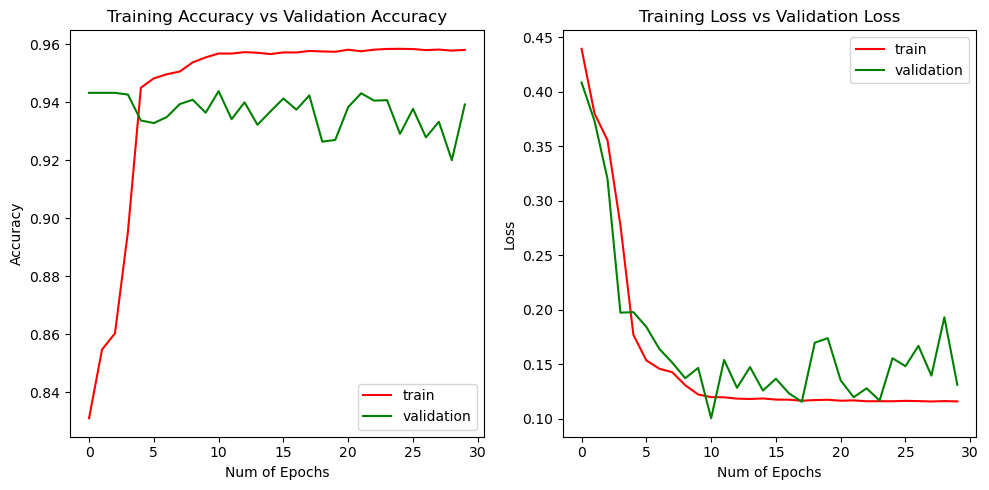

In [231]:
_, ax = plt.subplots(1, 2, figsize=(10, 5), dpi=100)
ax[0].plot(history.history['acc'], 'r')
ax[0].plot(history.history['val_acc'], 'g')
ax[0].set_xlabel("Num of Epochs")
ax[0].set_ylabel("Accuracy")
ax[0].set_title("Training Accuracy vs Validation Accuracy")
ax[0].legend(['train', 'validation'])

ax[1].plot(history.history['loss'], 'r')
ax[1].plot(history.history['val_loss'], 'g')
ax[1].set_xlabel("Num of Epochs")
ax[1].set_ylabel("Loss")
ax[1].set_title("Training Loss vs Validation Loss")
ax[1].legend(['train', 'validation'])

plt.tight_layout()

In [232]:
y_hat = model.predict(x=dfinput_x)
y_hat

array([[0.00486027, 0.9951397 ],
       [0.15399502, 0.84600496],
       [0.01760015, 0.9823998 ],
       ...,
       [0.26468396, 0.7353161 ],
       [0.99434966, 0.00565038],
       [0.9951382 , 0.00486181]], dtype=float32)

In [233]:
y_pred_label = np.argmax(y_hat, axis = 1)
y_true_label = np.argmax(dfinput_y, axis = 1)

In [234]:
y_pred_label

array([1, 1, 1, ..., 1, 0, 0])

In [235]:
unique, counts = np.unique(y_pred_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 32135],
       [    1, 35017]])

In [236]:
y_true_label

array([1, 1, 1, ..., 0, 0, 0])

In [237]:
unique, counts = np.unique(y_true_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 33576],
       [    1, 33576]])

In [238]:
tabla = pd.crosstab(y_pred_label, y_true_label)
tabla

col_0,0,1
row_0,,
0,31413,722
1,2163,32854
